<a href="https://colab.research.google.com/github/ThisGuyEddie/Interactive-Lab-Hub/blob/master/HRV_Respiration_Rate_Correlation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
rr = pd.read_csv("/content/drive/My Drive/BreathingSensing/record_206698/RR_interval_epoch.csv")

print(rr)

           time [s]  ...  RR_interval_quality [na] (/api/datatype/1004/)
0      1.600531e+09  ...                                             129
1      1.600531e+09  ...                                             129
2      1.600531e+09  ...                                             129
3      1.600531e+09  ...                                             129
4      1.600531e+09  ...                                             129
...             ...  ...                                             ...
38081  1.600559e+09  ...                                             129
38082  1.600559e+09  ...                                               1
38083  1.600559e+09  ...                                               1
38084  1.600559e+09  ...                                               1
38085  1.600559e+09  ...                                             129

[38086 rows x 3 columns]


In [ ]:
# https://stackoverflow.com/questions/6811183/rolling-window-for-1d-arrays-in-numpy/6811241#6811241
def rolling_window(a, window):
    shape = a.shape[:-1] + (a.shape[-1] - window + 1, window)
    strides = a.strides + (a.strides[-1],)
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)
# https://stackoverflow.com/a/59974675/1114105
def rolling_window2d(a, window_size):
    shape = (a.shape[0] - window_size + 1, window_size) + a.shape[1:]
    strides = (a.strides[0],) + a.strides
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)

In [ ]:
import numpy as np
np.set_printoptions(suppress=True)
# OK So first get the files up here. Epoch RR and Epoch Respiration Rate
rr = np.loadtxt("/content/drive/My Drive/BreathingSensing/record_206698/RR_interval_epoch.csv",delimiter=",",skiprows=1)
resp = np.loadtxt("/content/drive/My Drive/BreathingSensing/record_206698/outputData.csv",delimiter=",",skiprows=1)
rr = rr[:,:2]
resp = resp[:,[0,4]]
print(rr.shape)
print(resp.shape)
print(rr[0])

(38086, 2)
(28368, 2)
[1.60053082e+09 0.00000000e+00]


In [ ]:
# Next truncate RR times to integer and remove dupes by averaging values
import pandas as pd
rr[:,0]= np.trunc(rr[:,0])
rr_trunc = rr
resp[:,0] = np.trunc(resp[:,0])
resp_prep = resp
df_trunc =  pd.DataFrame({'time': rr_trunc[:, 0], 'rr': rr_trunc[:, 1]})
df_trunc_dedup = df_trunc.groupby('time').mean().reset_index()
rr_prep = df_trunc_dedup.to_numpy()
print(rr_prep.shape)

(27604, 2)


In [ ]:
!pip install pyhrv

     |████████████████████████████████| 3.2MB 2.7MB/s 
     |████████████████████████████████| 81kB 6.4MB/s 
     |████████████████████████████████| 235kB 24.4MB/s 
  Created wheel for spectrum: filename=spectrum-0.7.6-cp36-cp36m-linux_x86_64.whl size=234240 sha256=d5dbbe246ec2b8246dcb36c858b2a0c005aa18fdfa8eede0c02c1bf7f5be2835
  Stored in directory: /root/.cache/pip/wheels/7b/a1/1f/16e3bd0418dc16201a4f2e696ab00de3e3c95549cba7df5d13
Successfully built spectrum


In [ ]:
rr_prep

array([[1.60053082e+09, 0.00000000e+00],
       [1.60053082e+09, 5.72265625e-01],
       [1.60053082e+09, 2.57812500e-01],
       ...,
       [1.60055918e+09, 9.96093750e-01],
       [1.60055918e+09, 8.55468750e-01],
       [1.60055918e+09, 1.31250000e+00]])

In [ ]:
import pyhrv
# a = pyhrv.frequency_domain.welch_psd(rr_prep[1:100,1])
# a["fft_rel"][2]
hf = []
for i in range(100):
  a = pyhrv.frequency_domain.welch_psd(rr_prep[i*100:(i+1)*100,1], show=False, show_param = False)
  hf.append(a["fft_norm"][1])

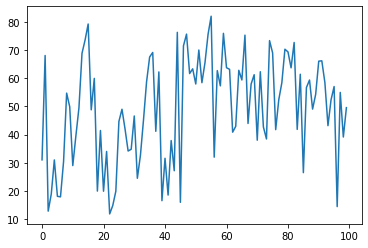

In [ ]:
from matplotlib import pyplot as pt
pt.plot(hf)

In [ ]:
# Now combine RR-Interval and Respiration rate for timestamps where we have both values
# Get intersection
intersecting_times, rr_ind, resp_ind  = np.intersect1d(rr_prep[:,0], resp_prep[:,0], return_indices=True)
print(intersecting_times.shape)
vitals = []
for idx_rr, idx_resp in zip(rr_ind, resp_ind):
  vitals.append([rr_prep[idx_rr,0], rr_prep[idx_rr,1], resp_prep[idx_resp,1]])
vitals = np.array(vitals)
print(vitals.shape)

(27604,)
(27604, 3)


In [ ]:
# Now remove timestamp
vitals_2d = vitals[:,1:]
print(vitals_2d.shape)

# Need to impute missing rr values (inc. 0's) instead of deleting them

(27604, 2)


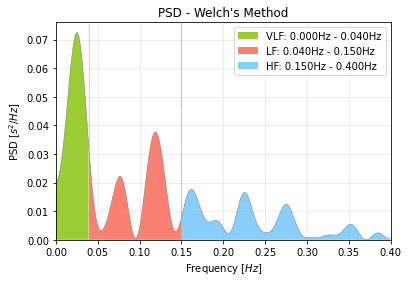

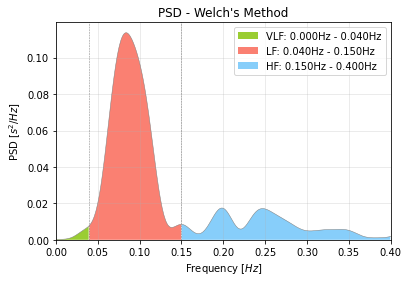

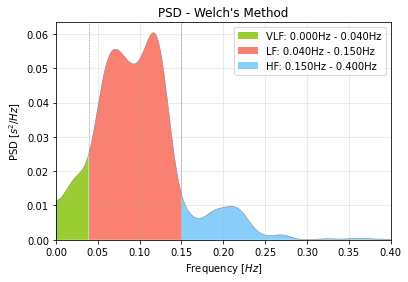

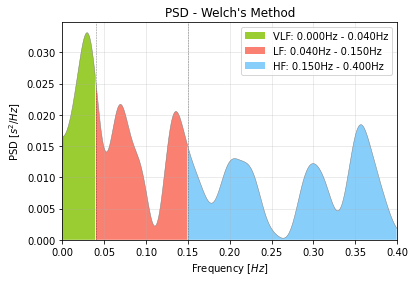

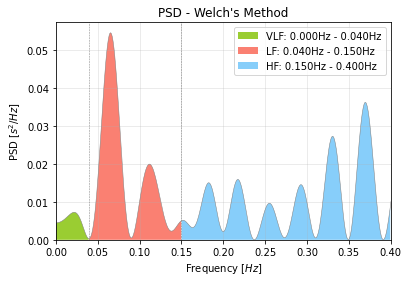

...

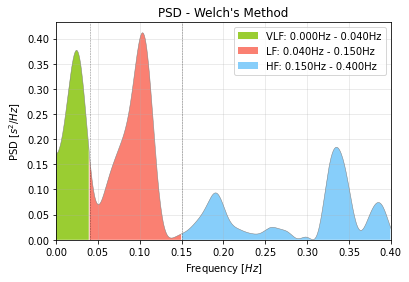

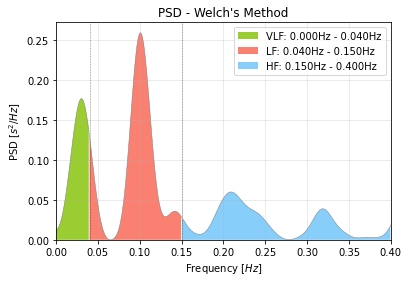

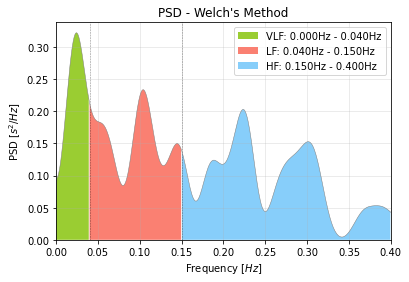

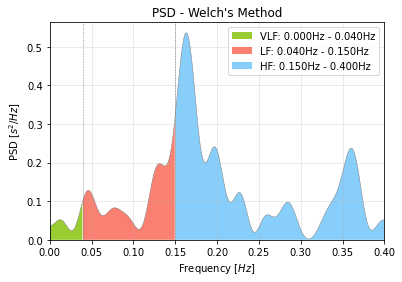

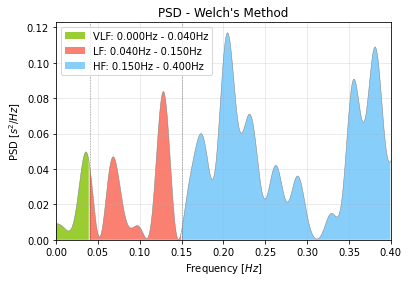

In [ ]:
import numpy as np
final_nn = vitals_2d[:,0]
final_breathing = vitals_2d[:,1]
datapoints = final_nn.shape[0]
hf = []
rmssd = []
avg_breathing = []
i = 0
while i + 60 < datapoints:
  freq_domain = pyhrv.frequency_domain.welch_psd(final_nn[i:i+60], show=False, show_param = False)
  hf.append(freq_domain["fft_norm"][1])

  time_domain = pyhrv.time_domain.rmssd(final_nn[i:i+60])
  rmssd.append(time_domain["rmssd"])

  breathing_rate = np.average(final_breathing[i:i+60])
  avg_breathing.append(breathing_rate)
  i+= 30

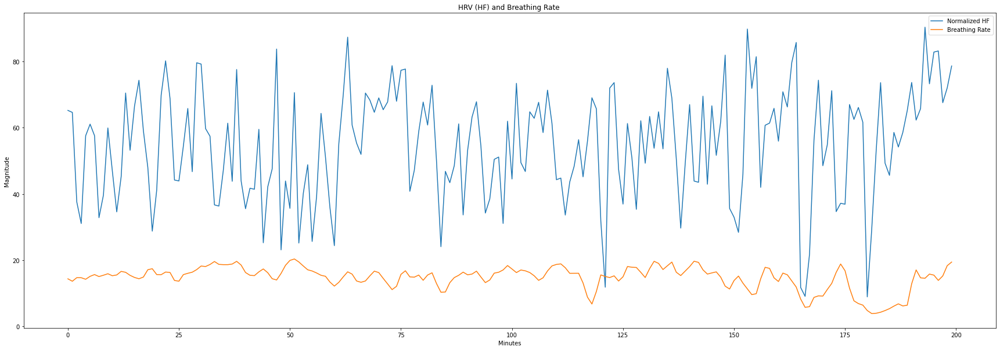

In [ ]:
from matplotlib import pyplot as pt
fig, ax1 = pt.subplots(figsize=(30, 10))

pt.plot(hf[200:400], label="Normalized HF")
pt.plot(avg_breathing[200:400], label="Breathing Rate")
pt.legend()
pt.title("HRV (HF) and Breathing Rate ")
pt.xlabel("Minutes")
pt.ylabel("Magnitude")
pt.show()

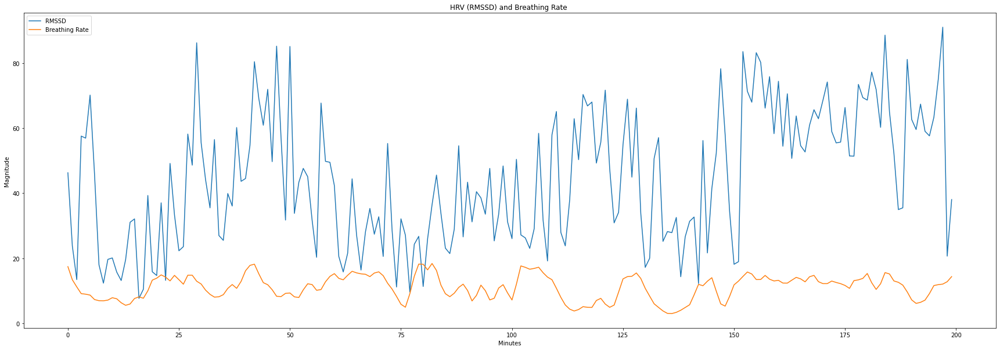

In [ ]:
from matplotlib import pyplot as plt
fig, ax1 = plt.subplots(figsize=(30, 10))

pt.plot(hf[00:200], label="RMSSD")
pt.plot(avg_breathing[00:200], label="Breathing Rate")
pt.legend()
pt.title("HRV (RMSSD) and Breathing Rate ")
pt.xlabel("Minutes")
pt.ylabel("Magnitude")
pt.show()

In [ ]:
hf_low_t = np.quantile(hf, .2)
rmssd_low_t = np.quantile(rmssd, .20)
hf_class = []
for i in range(0, len(hf)):
  if hf[i] <= hf_low_t:
    hf_class.append(0)
  else:
    hf_class.append(1)
rmssd_class = []
for i in range(0, len(rmssd)):
  if rmssd[i] <= rmssd_low_t:
    rmssd_class.append(0)
  else:
    rmssd_class.append(1)

In [ ]:
from sklearn.datasets import load_iris
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
avg_breathing = np.array(avg_breathing)
hf_class = np.array(hf_class)
X_train, X_test, y_train, y_test = train_test_split(
    avg_breathing, hf_class, test_size=0.33, random_state=42)
X_train = X_train.reshape(-1,1)
X_test = X_test.reshape(-1,1)

clf = LogisticRegression(random_state=0, solver="liblinear").fit(X_train, y_train)
clf.score(X_test, y_test)


0.7960526315789473

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    avg_breathing, rmssd_class, test_size=0.33, random_state=42)
X_train = X_train.reshape(-1,1)
X_test = X_test.reshape(-1,1)

clf = LogisticRegression(random_state=0, solver="liblinear").fit(X_train, y_train)
clf.score(X_test, y_test)
clf.predict(X_test)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [ ]:
combined_hrv = np.stack((hf_class,rmssd_class),1)
combined_hrv

array([[1, 1],
       [0, 0],
       [0, 0],
       ...,
       [1, 1],
       [1, 1],
       [1, 1]])

In [ ]:
# Then, Calculate HRV using 2 minute windows
np.set_printoptions(suppress=True,
   formatter={'float_kind':'{:f}'.format})


windows = rolling_window(vitals_2d[:,0], 120)
print(windows.shape)
hrvs = []
for window in windows:
  hrv = np.sqrt(np.mean(np.square(np.diff(window))))
  hrvs.append(hrv)
hrvs = np.array(hrvs)
print(hrvs.shape)
# print(hrv)


(27485, 120)
(27485,)


In [ ]:
# Delete first two mins of resp data
num_to_truncate = vitals_2d.shape[0] - hrvs.shape[0]
# print(num_to_truncate)
# print(vitals_2d[num_to_truncate:,1].shape)
resp_final = vitals_2d[num_to_truncate:,1]
hrv_resp = np.vstack((hrvs, resp_final)).T
print(hrv_resp.shape)
print(hrv_resp[0:10])

(27485, 2)
[[0.134370 8.000000]
 [0.123706 8.000000]
 [0.120303 8.000000]
 [0.080908 7.000000]
 [0.065295 7.000000]
 [0.065030 7.000000]
 [0.065035 8.000000]
 [0.063961 8.000000]
 [0.062131 8.000000]
 [0.067866 8.000000]]


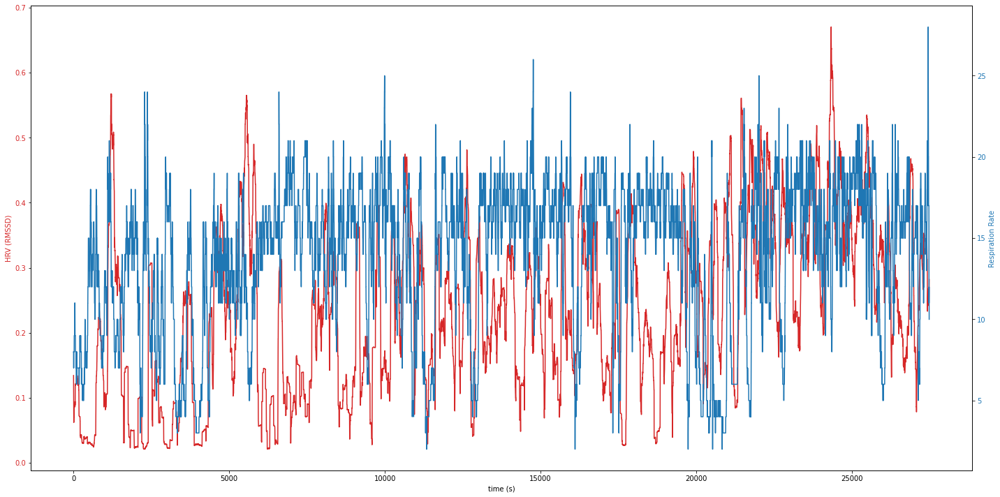

In [ ]:
# https://matplotlib.org/gallery/api/two_scales.html
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(figsize=(20, 10))
t = np.arange(1, hrv_resp.shape[0] + 1, 1)
color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('HRV (RMSSD)', color=color)
ax1.plot(t, hrv_resp[:,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Respiration Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(t, hrv_resp[:,1], color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

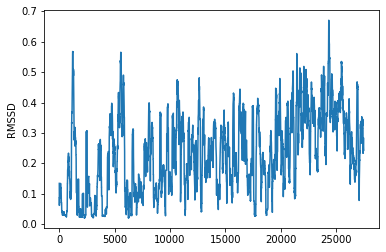

In [ ]:
import matplotlib.pyplot as plt
plt.plot(hrv_resp[:,0])
plt.ylabel('RMSSD')
plt.show()


In [ ]:
#Quantile RMSSD
hrv = hrv_resp[:,0]
high_anxiety_hrv_threshold = np.quantile(hrv,.05)
high_anxiety_hrv_threshold

0.03179326009449132

In [ ]:
hrv_resp[272]

array([0.031167, 6.000000])

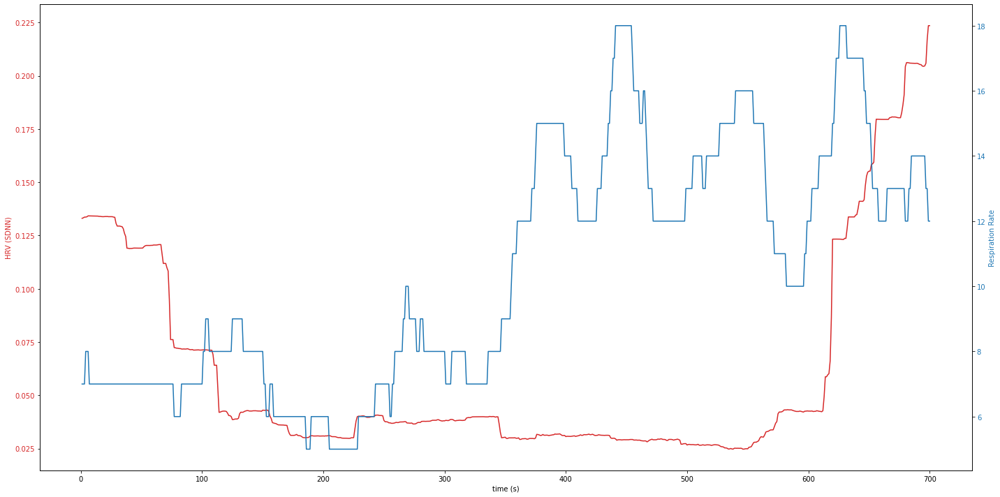

In [ ]:
# https://matplotlib.org/gallery/api/two_scales.html
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(figsize=(20, 10))
t = np.arange(1, 701, 1)
color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('HRV (SDNN)', color=color)
ax1.plot(t, hrv_resp[100:800,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Respiration Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(t, hrv_resp[100:800,1], color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

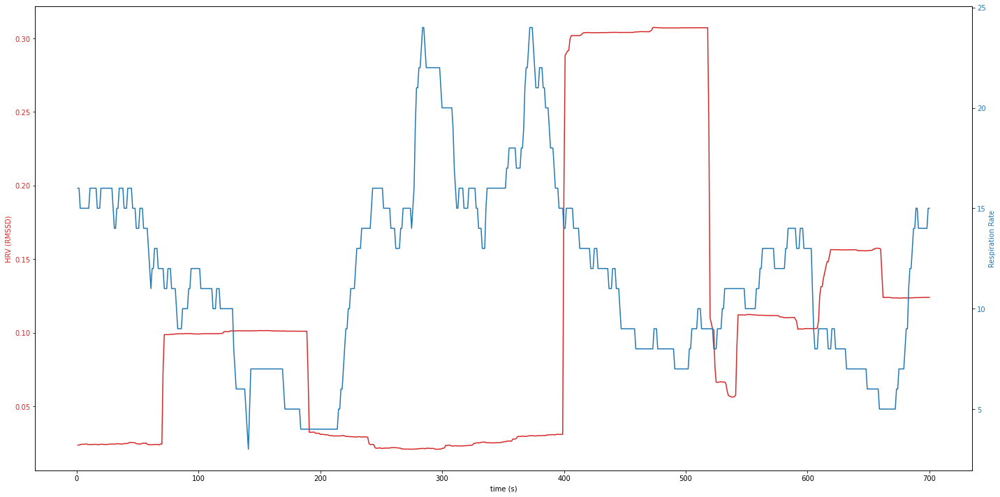

In [ ]:
# https://matplotlib.org/gallery/api/two_scales.html
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(figsize=(20, 10))
t = np.arange(1, 701, 1)
color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('HRV (RMSSD)', color=color)
ax1.plot(t, hrv_resp[2000:2700,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Respiration Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(t, hrv_resp[2000:2700,1], color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

In [ ]:
 # What does breathing look like?
high_anxiety_breathing =  np.where(hrv_resp[:,0] < high_anxiety_hrv_threshold)
high_anxiety_breathing[0].shape
respiration_during_low_hrv = hrv_resp[high_anxiety_breathing[0]][:,1]

In [ ]:
respiration_during_low_hrv.shape

(1375,)

In [ ]:
high_anxiety_breathing[0][500:900]

array([2274, 2275, 2276, 2277, 2278, 2279, 2280, 2281, 2282, 2283, 2284,
       2285, 2286, 2287, 2288, 2289, 2290, 2291, 2292, 2293, 2294, 2295,
       2296, 2297, 2298, 2299, 2300, 2301, 2302, 2303, 2304, 2305, 2306,
       2307, 2308, 2309, 2310, 2311, 2312, 2313, 2314, 2315, 2316, 2317,
       2318, 2319, 2320, 2321, 2322, 2323, 2324, 2325, 2326, 2327, 2328,
       2329, 2330, 2331, 2332, 2333, 2334, 2335, 2336, 2337, 2338, 2339,
       2340, 2341, 2342, 2343, 2344, 2345, 2346, 2347, 2348, 2349, 2350,
       2351, 2352, 2353, 2354, 2355, 2356, 2357, 2358, 2359, 2360, 2361,
       2362, 2363, 2364, 2365, 2366, 2367, 2368, 2369, 2370, 2371, 2372,
       2373, 2374, 2375, 2376, 2377, 2378, 2379, 2380, 2381, 2382, 2383,
       2384, 2385, 2386, 2387, 2388, 2389, 2390, 2391, 2392, 2393, 2394,
       2395, 2396, 2397, 2398, 2909, 2910, 2911, 2912, 2913, 2914, 2915,
       2916, 2917, 2918, 2919, 2920, 2921, 2922, 2923, 2924, 2925, 2926,
       2927, 2928, 2929, 2930, 2931, 2932, 2933, 29

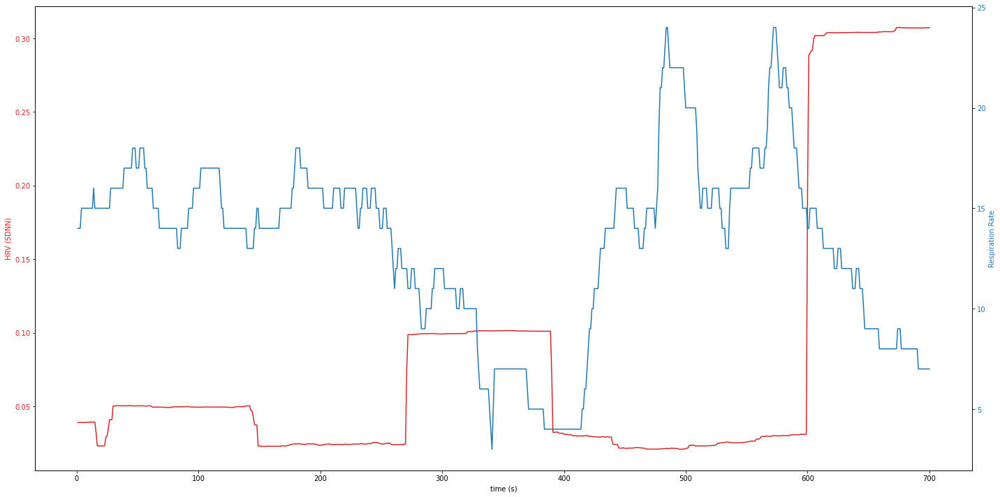

In [ ]:
# https://matplotlib.org/gallery/api/two_scales.html
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(figsize=(20, 10))
t = np.arange(1, 701, 1)
color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('HRV (SDNN)', color=color)
ax1.plot(t, hrv_resp[1800:2500,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Respiration Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(t, hrv_resp[1800:2500,1], color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

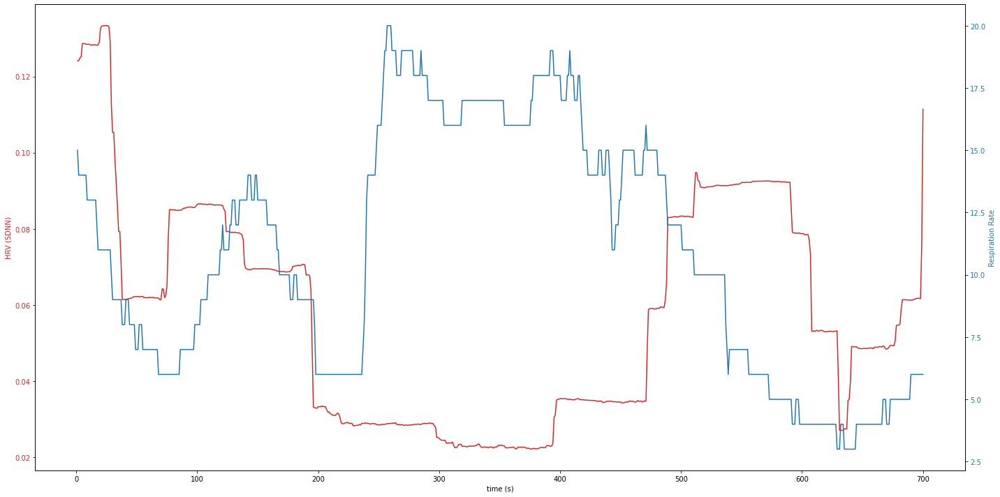

In [ ]:
# https://matplotlib.org/gallery/api/two_scales.html
import matplotlib.pyplot as plt
fig, ax1 = plt.subplots(figsize=(20, 10))
t = np.arange(1, 701, 1)
color = 'tab:red'
ax1.set_xlabel('time (s)')
ax1.set_ylabel('HRV (SDNN)', color=color)
ax1.plot(t, hrv_resp[2700:3400,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Respiration Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(t, hrv_resp[2700:3400,1], color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

In [ ]:
from scipy.stats import ttest_ind, ttest_ind_from_stats
t, p = ttest_ind(respiration_during_low_hrv, hrv_resp[:,1], equal_var=False)
p

2.906297948372362e-14

In [ ]:
import pandas as pd
import numpy as np

df_describe = pd.DataFrame(respiration_during_low_hrv)
df_describe.describe()

,0
count,1375.000000
mean,12.730909
std,5.446073
min,3.000000
25%,6.000000
50%,15.000000
75%,17.000000
max,24.000000


In [ ]:
df_describe = pd.DataFrame(hrv_resp[:,1])
df_describe.describe()

,0
count,27485.000000
mean,13.878006
std,4.520591
min,2.000000
25%,11.000000
50%,15.000000
75%,17.000000
max,28.000000


In [ ]:
breathing = hrv_resp[:,1]
fast_breathing_threshold = np.quantile(breathing,.95)
fast_breathing_threshold

20.0

In [ ]:
fast_breathing_hrv =  np.where(hrv_resp[:,1] > fast_breathing_threshold)
fast_breathing_hrv[0].shape
hrv_during_fast_breathing = hrv_resp[fast_breathing_hrv[0]][:,0]

In [ ]:
hrv_during_fast_breathing

array([0.369173, 0.369150, 0.021194, 0.021169, 0.021395, 0.021484,
       0.021473, 0.021462, 0.021626, 0.021313, 0.021647, 0.021683,
       0.021620, 0.021620, 0.021502, 0.021562, 0.021560, 0.021130,
       0.020993, 0.020981, 0.021011, 0.021140, 0.021018, 0.029779,
       0.029641, 0.029882, 0.030032, 0.030218, 0.030165, 0.030123,
       0.030114, 0.030108, 0.029954, 0.030159, 0.030233, 0.030273,
       0.030173, 0.030287, 0.030280, 0.030294, 0.269168, 0.272192,
       0.284358, 0.284775, 0.287437, 0.291731, 0.293661, 0.294557,
       0.294557, 0.294543, 0.123368, 0.123365, 0.123338, 0.123339,
       0.123343, 0.123345, 0.123270, 0.123270, 0.123276, 0.123274,
       0.123283, 0.108063, 0.108062, 0.108045, 0.108074, 0.108084,
       0.108042, 0.103594, 0.103589, 0.103650, 0.103705, 0.098300,
       0.098192, 0.098185, 0.098145, 0.098173, 0.098213, 0.098252,
       0.098244, 0.098244, 0.071170, 0.071006, 0.071015, 0.070930,
       0.070914, 0.070979, 0.071098, 0.071048, 0.071055, 0.071

In [ ]:
df_describe = pd.DataFrame(hrv_during_fast_breathing)
df_describe.describe()

,0
count,475.000000
mean,0.246434
std,0.127239
min,0.020981
25%,0.152857
50%,0.251147
75%,0.343599
max,0.535002


In [ ]:
df_describe = pd.DataFrame(hrv_resp[:,0])
df_describe.describe()

,0
count,27485.000000
mean,0.237111
std,0.129284
min,0.020981
25%,0.132237
50%,0.233663
75%,0.338747
max,0.670176


In [ ]:
hrv_resp[:,1]

array([8.000000, 8.000000, 8.000000, ..., 12.000000, 11.000000, 10.000000])

In [ ]:
from scipy.stats import ttest_ind, ttest_ind_from_stats
t, p = ttest_ind(respiration_during_low_hrv, hrv_resp[:,1], equal_var=False)
p

2.906297948372362e-14

In [ ]:
respiration

2.906297948372362e-14

In [ ]:
# Window the data and compute correlation over time

In [ ]:
rolld_hrv_resp  = rolling_window2d(hrv_resp, 2000)
print(rolld_hrv_resp.shape)
corrs = []
for i in range(0,rolld_hrv_resp.shape[0]):
  corr = np.corrcoef(rolld_hrv_resp[i,:,0],rolld_hrv_resp[i,:,1])
  corrs.append(corr[0,1])
len(corrs)

(25486, 2000, 2)


25486

In [ ]:
corrs = np.array(corrs)
print(corrs.shape)
print(corrs[0])

(25486,)
0.09051299598617009


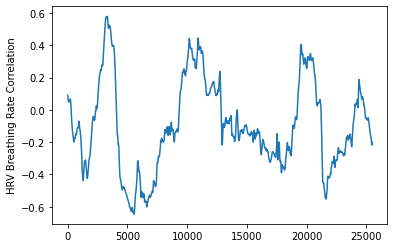

In [ ]:
import matplotlib.pyplot as plt
ar = np.arange(len(corrs))
plt.plot(ar,corrs)
plt.ylabel('HRV Breathing Rate Correlation')
plt.show()

In [ ]:
hrv_resp.shape
shuffled_sets = []
for i in range(0,100):
  shuffled = np.random.permutation(hrv_resp)
  shuffled_sets.append(shuffled)

shuffled_cors = []
ctr = 0
for shuffled_set in shuffled_sets:
  rolld_set  = rolling_window2d(shuffled_set, 2000)
  set_correlations = []
  for i in range(0,rolld_set.shape[0]):
    corr = np.corrcoef(rolld_set[i,:,0],rolld_set[i,:,1])
    set_correlations.append(corr[0,1])
  shuffled_cors.append(set_correlations)
  ctr += 1
  if ctr % 10 == 0:
    print(ctr)


10
20
30
40
50
60
70
80
90
100


In [ ]:
shuffled_cors = np.array(shuffled_cors)
shuffled_cors.shape

(100, 25486)

In [ ]:
quantiles = np.quantile(shuffled_cors,[.005,.05,.95,.995],axis=0)
quantiles.shape


(4, 25486)

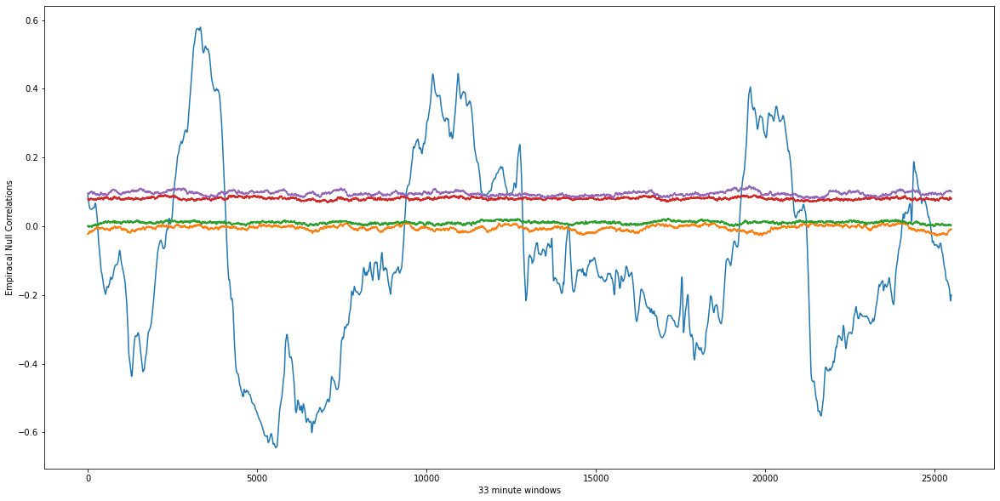

In [ ]:
import matplotlib.pyplot as plt
plt.subplots(figsize=(20, 10))
ar = np.arange(len(corrs))
plt.plot(ar,corrs)
ar2 = np.arange(quantiles.shape[1])
plt.plot(ar2,quantiles[0,:])
plt.plot(ar2,quantiles[1,:])
plt.plot(ar2,quantiles[2,:])
plt.plot(ar2,quantiles[3, :])


plt.ylabel('Empiracal Null Correlations')
plt.xlabel('33 minute windows')
plt.show()

In [ ]:
# /content/drive/My Drive/BreathingSensing/record_206541/outputData.csv